<a href="https://colab.research.google.com/github/MarianaSaenz/deep_learning/blob/main/CNN_image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Image classification**

Authors: Jorge Cueva, Duncan Rollier, Mariana Saenz

In [ ]:
!pip install keras --upgrade --quiet
!pip install tensorflow --upgrade --quiet
!pip install scikeras --quiet
!pip install keras-tuner --quiet

In [ ]:
### connect to drive
from google.colab import drive
drive.mount('/content/drive/')

import sys
sys.path.append('/content/drive/MyDrive/DL_Assignment_2/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
### import modules
import json
from math import e
import numpy as np
from sklearn.model_selection import train_test_split
import keras
from keras.callbacks import BackupAndRestore, History, ModelCheckpoint
from keras.layers import Dense
from keras.models import Sequential
from keras import layers
import seaborn as sns
import matplotlib.pyplot as plt
from glob import glob, iglob
import tensorflow as tf
import os
from os.path import basename, isdir
import keras.applications.resnet50 as resnet50
from sklearn.metrics import ConfusionMatrixDisplay, accuracy_score, top_k_accuracy_score, classification_report
from sklearn.neighbors import KNeighborsClassifier
from keras.layers import BatchNormalization, Conv2D, Dense, Dropout, GlobalAveragePooling2D, Input
from keras.models import Model, Sequential
from keras.preprocessing import image
from keras.utils import to_categorical
from keras.metrics import F1Score
import tensorflow_datasets as tfds
from PIL import Image
import pathlib
import pickle
from keras.applications.resnet50 import preprocess_input, decode_predictions
import gc
from keras import backend as K
import keras_tuner as kt


In [ ]:
def clean_memory():
    gc.collect()
    K.clear_session()

Since I only have .pickle data, jump to "Loading previously preprocessed and saved data"

## Data importing and preprocessing

In [ ]:
image_dir = pathlib.Path('/content/drive/MyDrive/DL_Assignment_2/images')

dataset = keras.preprocessing.image_dataset_from_directory(image_dir,
                                                             color_mode = "rgb",
                                                             labels = 'inferred',
                                                             shuffle=True,  # Shuffle the dataset
                                                             seed=42,  # Set a random seed for reproducibility,
                                                             class_names = ('bbq','dessert', 'pasta', 'salad', 'sushi'),
                                                             batch_size = None
                                                            )


Found 1443 files belonging to 5 classes.


In [ ]:
class_names = dataset.class_names
print(class_names)
print(len(dataset))


('bbq', 'dessert', 'pasta', 'salad', 'sushi')
1443


In [ ]:
def split_dataset_into_images_and_labels(dataset):
  X = []
  Y = []

  for images, labels in dataset:
      X.append(images.numpy())
      Y.append(labels.numpy())

  X_all = np.array(X)
  Y_all = np.array(Y)

  print("Images Shape:", X_all.shape)
  print("Labels Shape:", Y_all.shape)

  return X_all, Y_all

x_all, y_all = split_dataset_into_images_and_labels(dataset)

Images Shape: (1443, 256, 256, 3)
Labels Shape: (1443,)


In [ ]:
# Split into train/validation set
validation_ratio = 0.3 #also test ratio
x_train, x_valid, y_train, y_valid = train_test_split(x_all, y_all, test_size=validation_ratio)
x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size=validation_ratio)

# Convert labels to one-hot encoding
y_train_oh = keras.utils.to_categorical(y_train)
y_valid_oh = keras.utils.to_categorical(y_valid)
y_test_oh = keras.utils.to_categorical(y_test)

print(len(x_train))
print(len(x_test))
print(len(x_valid))

# the validation set is bigger than the test set but that is no problem

707
303
433


In [ ]:
resize = tf.keras.Sequential([
  layers.Resizing(
    224,
    224,
    interpolation='bilinear',
    crop_to_aspect_ratio=False)])

x_train = resize(x_train)
x_test = resize(x_test)
x_valid = resize(x_valid)


In [ ]:
# Save data
#with open('/content/drive/MyDrive/DL_Assignment_2/data.pickle', 'wb') as f:
#    pickle.dump((x_all, x_train, x_valid, y_all, y_train, y_valid, x_test, y_test, y_train_oh, y_valid_oh, y_test_oh), f)


## Data exploration

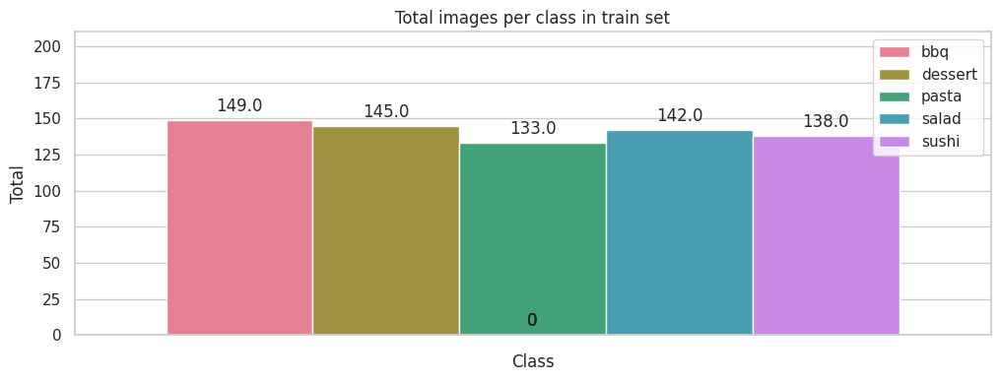

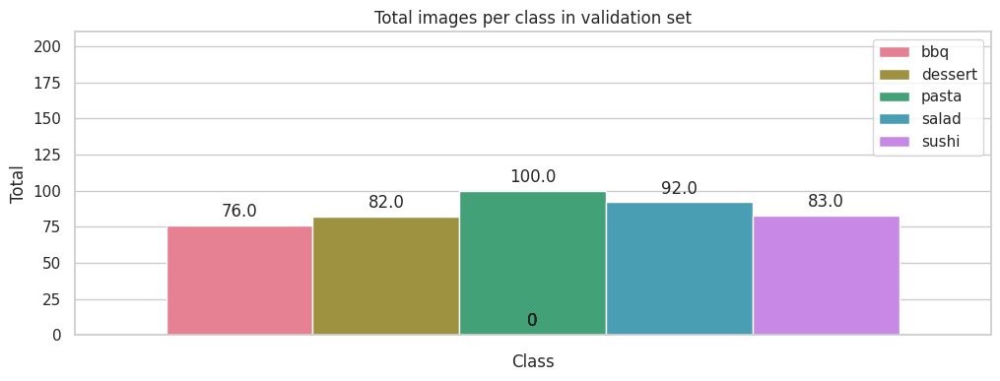

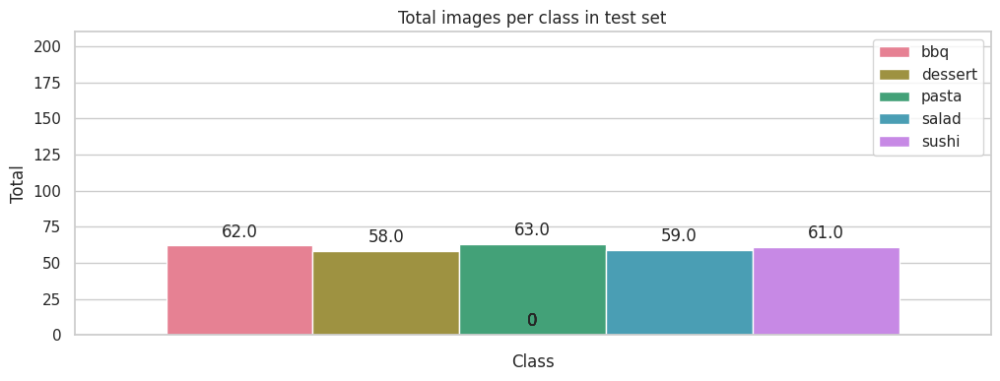

In [ ]:
# Data exploration to check whether the labels are +/- equally distributed (which appears to be the case)

data_frames = [y_train, y_valid, y_test]
data_frame_names = ['train set', 'validation set', 'test set']
start = 0

for data in data_frames:
  Class = {
      0: 'bbq', 1:'dessert', 2:'pasta', 3:'salad', 4:'sushi'}

  Counts = {
      'bbq':0, 'dessert':0, 'pasta':0, 'salad':0, 'sushi':0
  }

  for feature in data:
    Counts[Class[feature]] += 1

  sns.set(style="whitegrid")
  colors = sns.color_palette("husl", len(Counts))

  plt.figure(figsize=(12, 4))
  ax = sns.barplot(hue=list(Counts.keys()), y=list(Counts.values()), palette=colors, legend=True)
  ax.set(xlabel="Class", ylabel="Total", title=f"Total images per class in {data_frame_names[start]}")

  for p in ax.patches:
      ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha="center", va="center", xytext=(0, 10), textcoords="offset points")

  plt.ylim(0, 210)
  plt.show() # Data set is apparently balanced
  start+=1


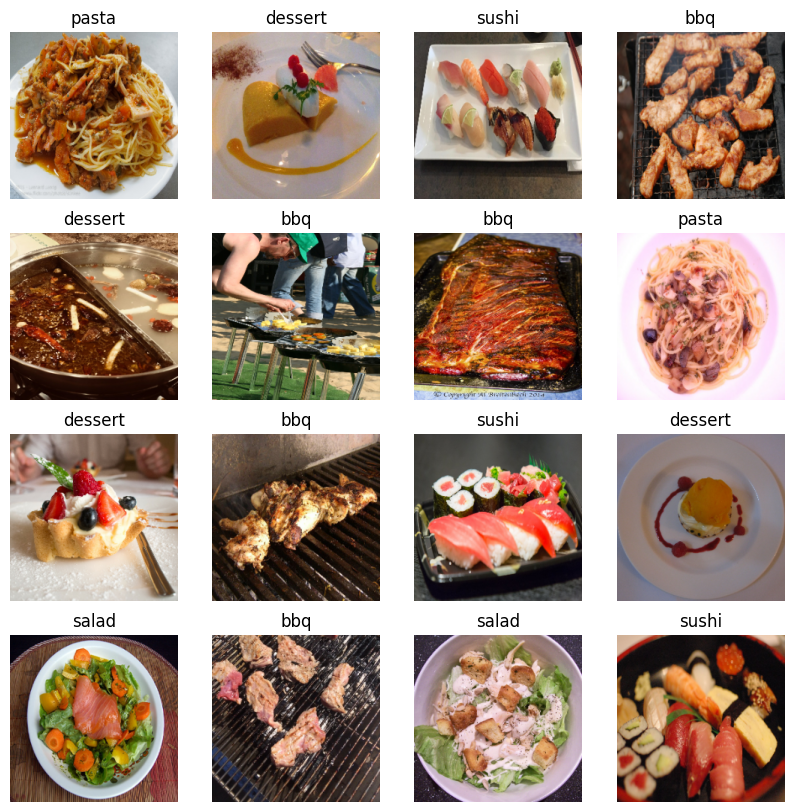

In [ ]:
plt.figure(figsize=(10, 10))
amount = 100

for i in range(16):
  ax = plt.subplot(4, 4, i + 1)
  plt.imshow(x_train[i].numpy().astype("uint8"))
  plt.title(class_names[(y_train[i])])

  plt.axis("off")

## Data augmentation

In [ ]:
## https://www.tensorflow.org/tutorials/images/data_augmentation
seed = 0
augmentation_layers = [
    layers.RandomFlip("horizontal_and_vertical", seed=seed),
    layers.RandomRotation(0.2, seed=seed),
    layers.RandomContrast(0.6, seed=seed),
    layers.RandomCrop(200,200, seed=seed),
    layers.Resizing(224,224,interpolation='bilinear',crop_to_aspect_ratio=False)
    ]

def data_augmentation(x):
    for layer in augmentation_layers:
        x = layer(x)
    return x

augmented_x_train = data_augmentation(x_train)

In [ ]:
# create new augmented dataset with train images and new modified images

x_aug = np.concatenate([x_train, augmented_x_train])
y_aug = np.concatenate([y_train, y_train])

# shuffled indices to randomize
indices = np.arange(len(x_aug))
np.random.shuffle(indices)

x_aug = x_aug[indices]
y_aug = y_aug[indices]

y_aug_oh = keras.utils.to_categorical(y_aug)

In [ ]:
# merge augmented dataset with validation dataset

x_train_aug_valid = np.concatenate([x_aug, x_valid])
y_train_aug_valid = np.concatenate([y_aug, y_valid])

# shuffled indices to randomize
indices = np.arange(len(x_train_aug_valid))
np.random.shuffle(indices)

x_train_aug_valid = x_train_aug_valid[indices]
y_train_aug_valid = y_train_aug_valid[indices]

y_train_aug_valid_oh = keras.utils.to_categorical(y_train_aug_valid)

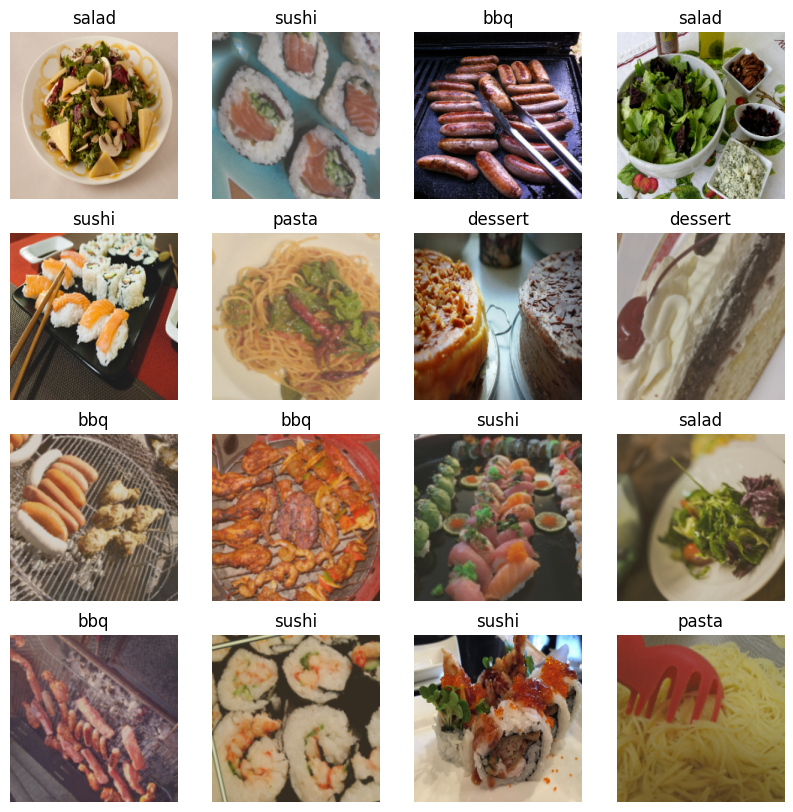

In [ ]:
## check labels are correct
plt.figure(figsize=(10, 10))
amount = 100

for i in range(16):
  ax = plt.subplot(4, 4, i + 1)
  plt.imshow(x_aug[i].astype("uint8"))

  plt.title(class_names[(y_aug[i])])

  plt.axis("off")


In [ ]:
# Save data
with open('/content/drive/MyDrive/DL_Assignment_2/data_aug.pickle', 'wb') as f:
    pickle.dump((x_aug, y_aug, y_aug_oh, x_train_aug_valid, y_train_aug_valid, y_train_aug_valid_oh), f)


## Loading previously preprocessed and saved data

In [ ]:
# Load data (for when the kernel crashes)
with open('/content/drive/MyDrive/MSc/DL/DL_Assignment_2/data_aug.pickle', 'rb') as f:
    x_aug, y_aug, y_aug_oh, x_train_aug_valid, y_train_aug_valid, y_train_aug_valid_oh = pickle.load(f)

In [ ]:
# Load data (for when the kernel crashes)
with open('/content/drive/MyDrive/MSc/DL/DL_Assignment_2/data.pickle', 'rb') as f:
    x_all, x_train, x_valid, y_all, y_train, y_valid, x_test, y_test, y_train_oh, y_valid_oh, y_test_oh = pickle.load(f)

In [ ]:
class_names = ('bbq', 'dessert', 'pasta', 'salad', 'sushi')

## Normalization

In [ ]:
# Normalization
import numpy as np

# Assuming your image is named 'image' and mean and std are provided
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# Convert image to numpy array if it's not already
x_aug_norm = np.array(x_aug)
x_aug_norm = x_aug / 255.0

# Normalize the image
x_aug_norm = (x_aug - np.array(mean)) / np.array(std)

###
x_valid_norm = np.array(x_valid)
x_valid_norm = x_valid / 255.0

# Normalize the image
x_valid_norm = (x_valid - np.array(mean)) / np.array(std)

###
x_test_norm = np.array(x_test)
x_test_norm = x_test / 255.0

# Normalize the image
x_test_norm = (x_test - np.array(mean)) / np.array(std)


###

x_train_aug_valid_norm = np.array(x_train_aug_valid)
x_train_aug_valid_norm = x_train_aug_valid / 255.0


# Normalize the image
x_train_aug_valid_norm = (x_train_aug_valid - np.array(mean)) / np.array(std)

# Model

Resnet50 arquitecture (from https://towardsdatascience.com/the-annotated-resnet-50-a6c536034758)
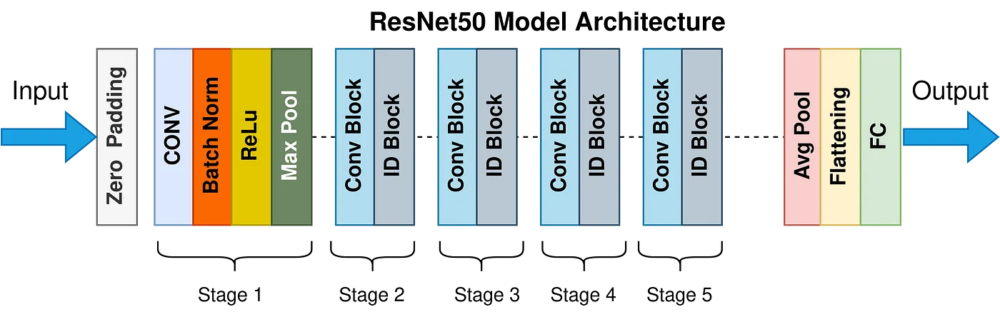

In [ ]:
batch_size = 32
epochs = 10

In [ ]:
model = resnet50.ResNet50(weights="imagenet", include_top=True)
x = model.output

x = Dense(64, activation="relu")(x)
x = Dropout(0.25)(x)

predictions = Dense(y_aug_oh.shape[1],
                    activation="softmax")(x)

fullmodel = Model(inputs=model.input,
                  outputs=predictions)

# the new layers we've added will hence remain trainable
for layer in model.layers:
    layer.trainable = False

fullmodel.compile(loss="categorical_crossentropy",
                  optimizer="adam", metrics=[F1Score("macro")])

# fullmodel.summary()

In [ ]:
epochs = 40
checkpoint_path = "fullmodel64.weights.h5"

cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 save_weights_only=True,
                                                 verbose=1)

stop_early = keras.callbacks.EarlyStopping(monitor="val_f1_score", mode='max', patience=5)

fullmodel.fit(
    x_aug, y_aug_oh, batch_size=batch_size, epochs=epochs, verbose=1, validation_data=(x_valid, y_valid_oh), callbacks=[stop_early, cp_callback])

clean_memory()

Epoch 1/40
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step - f1_score: 0.2607 - loss: 1.6020
Epoch 1: saving model to fullmodel64.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━ 38s 483ms/step - f1_score: 0.2623 - loss: 1.6018 - val_f1_score: 0.4990 - val_loss: 1.5666
Epoch 2/40
44/45 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - f1_score: 0.4621 - loss: 1.5554
Epoch 2: saving model to fullmodel64.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━ 17s 129ms/step - f1_score: 0.4620 - loss: 1.5548 - val_f1_score: 0.5406 - val_loss: 1.4888
Epoch 3/40
44/45 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - f1_score: 0.5100 - loss: 1.4847
Epoch 3: saving model to fullmodel64.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━ 6s 127ms/step - f1_score: 0.5111 - loss: 1.4835 - val_f1_score: 0.6082 - val_loss: 1.3806
Epoch 4/40
44/45 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - f1_score: 0.5502 - loss: 1.3787
Epoch 4: saving model to fullmodel64.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━ 10s 125ms/step - f1_score: 0.5500 - loss: 1.3778 - val_f1_score: 0.6746 - val_loss: 1.2

In [ ]:
# check name
fullmodel.load_weights('fullmodel64.weights.h5')

In [ ]:
### fine-tuning whole model with very low learning rate
checkpoint_path = "fullmodel_finetuning64.weights.h5"

cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 save_weights_only=True,
                                                 verbose=1)

# Unfreeze the base model
model.trainable = True

fullmodel.compile(optimizer=keras.optimizers.Adam(1e-5),
              loss="categorical_crossentropy",
              metrics=[F1Score("macro")])


fullmodel.fit(x_train_aug_valid, y_train_aug_valid_oh, batch_size=batch_size, epochs=10, callbacks=[cp_callback])

Epoch 1/10
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - f1_score: 0.8409 - loss: 0.4792
Epoch 1: saving model to fullmodel_finetuning64.weights.h5
58/58 ━━━━━━━━━━━━━━━━━━━━ 22s 186ms/step - f1_score: 0.8408 - loss: 0.4795
Epoch 2/10
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - f1_score: 0.8380 - loss: 0.4929
Epoch 2: saving model to fullmodel_finetuning64.weights.h5
58/58 ━━━━━━━━━━━━━━━━━━━━ 6s 101ms/step - f1_score: 0.8379 - loss: 0.4930
Epoch 3/10
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - f1_score: 0.8288 - loss: 0.5172
Epoch 3: saving model to fullmodel_finetuning64.weights.h5
58/58 ━━━━━━━━━━━━━━━━━━━━ 10s 97ms/step - f1_score: 0.8290 - loss: 0.5167
Epoch 4/10
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - f1_score: 0.8407 - loss: 0.4753
Epoch 4: saving model to fullmodel_finetuning64.weights.h5
58/58 ━━━━━━━━━━━━━━━━━━━━ 11s 104ms/step - f1_score: 0.8405 - loss: 0.4756
Epoch 5/10
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - f1_score: 0.8472 - loss: 0.4735
Epoch 5: saving model to fullmodel_f

In [ ]:
#fullmodel_norm.load_weights('fullmodel_finetuning_norm.weights.h5')
fullmodel.load_weights('fullmodel_finetuning64.weights.h5')

10/10 ━━━━━━━━━━━━━━━━━━━━ 7s 446ms/step
              precision    recall  f1-score   support

           0       0.81      0.89      0.85        62
           1       0.74      0.74      0.74        61
           2       0.88      0.80      0.84        65
           3       0.63      0.84      0.72        50
           4       0.83      0.62      0.71        65

    accuracy                           0.77       303
   macro avg       0.78      0.78      0.77       303
weighted avg       0.79      0.77      0.77       303



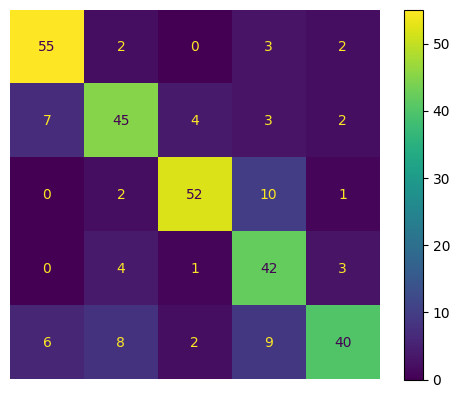

In [ ]:
## test
y_pred = fullmodel.predict(x_test, batch_size=batch_size)
clean_memory()
y_pred_c = np.argmax(y_pred, axis=1)
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_c, display_labels=class_names, xticks_rotation = "vertical") #note: get rid of the axis !!!!!
plt.axis("off")
print(classification_report(y_test, y_pred_c))

## Evaluation

Missclasified images

In [ ]:
# substracting the predictions from the true labels ==0 if the prediction is the same and !=0 if the prediction is wrong
y_zeros = y_test - y_pred_c

nonzero_indices = np.array(np.where(y_zeros != 0))
#print(nonzero_indices) #to see what images were missclassified
print(f'the model only missclasified {len(nonzero_indices[0])} of the images')

the model only missclasified 39 of the images


In [ ]:
image = x_train_aug[0]
plt.imshow(image.numpy().astype("uint8"))
plt.title(f"true: {class_names[true_label]} - predicted: {class_names[pred_label]}")
plt.axis("off")
plt.show()

NameError: name 'x_train_aug' is not defined

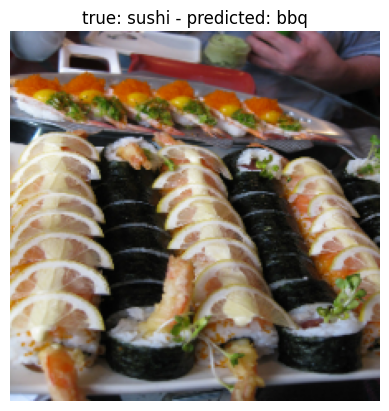

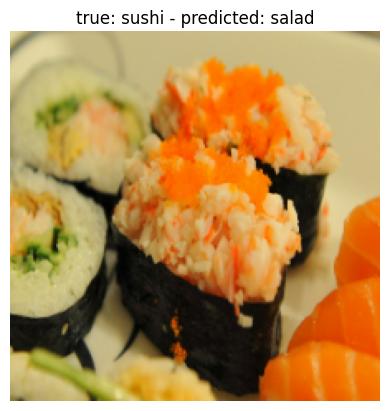

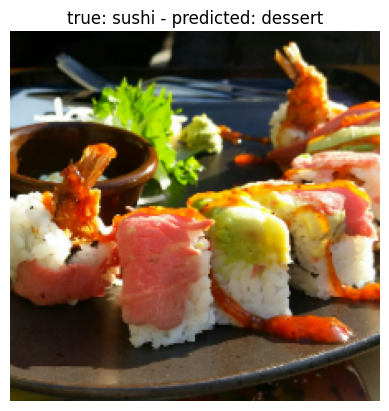

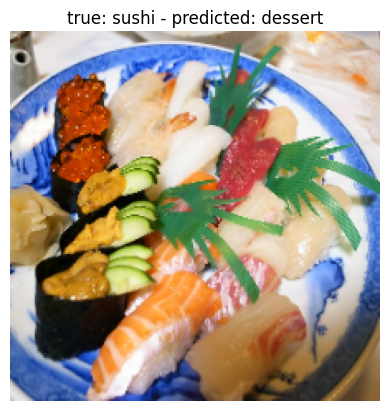

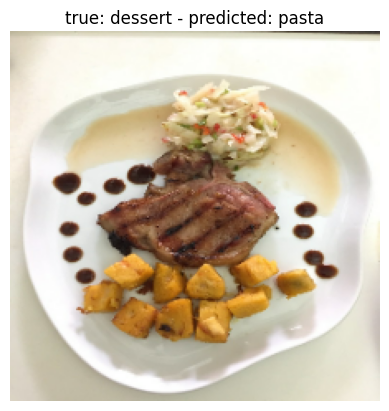

...

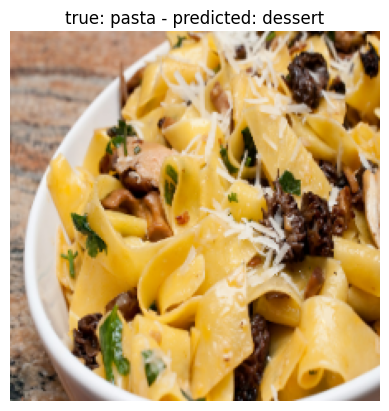

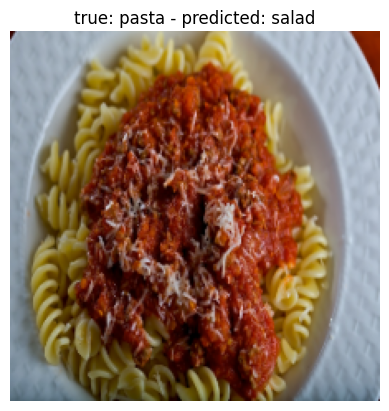

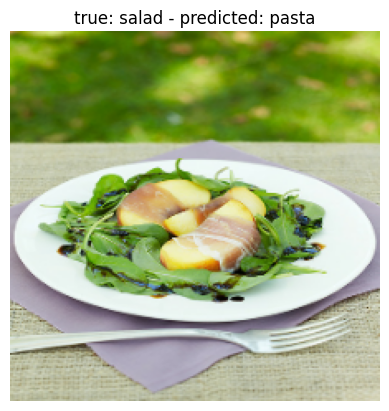

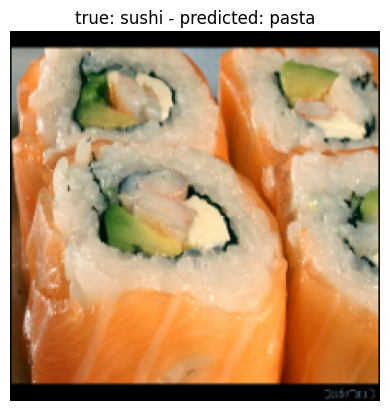

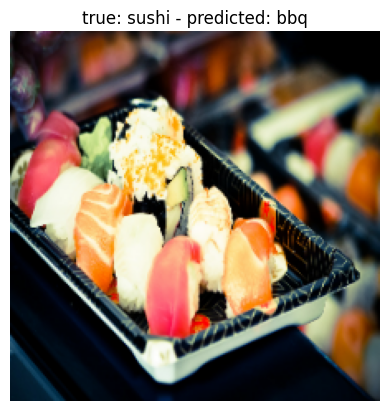

In [ ]:
for i, (image, true_label, pred_label) in enumerate(zip(x_test, y_test, y_pred_c)):
    if pred_label != true_label:
        plt.imshow(image.numpy().astype("uint8"))
        plt.title(f"true: {class_names[true_label]} - predicted: {class_names[pred_label]}")
        plt.axis("off")
        plt.show()

In [ ]:
def get_saliency_map(model, image, class_idx):
    with tf.GradientTape() as tape:
        tape.watch(image)
        predictions = model(image)

        loss = predictions[:, class_idx]

    # Get the gradients of the loss w.r.t to the input image.
    gradient = tape.gradient(loss, image)

    # take maximum across channels
    gradient = tf.reduce_max(gradient, axis=-1)

    # convert to numpy
    gradient = gradient.numpy()

    # normaliz between 0 and 1
    min_val, max_val = np.min(gradient), np.max(gradient)
    smap = (gradient - min_val) / (max_val - min_val + keras.backend.epsilon())

    return smap

# Interpretation

In [ ]:
#Use separate sets to know what it sees on each class
sep_sets = {'bbq':[], 'dessert':[], 'pasta':[], 'salad':[], 'sushi':[]}
for i in range(len(x_train)):
  sep_sets[class_names[y_train[i]]].append(x_train[i])

for name in class_names:
  sep_sets[name] = np.array(sep_sets[name])

conv_layers = [layer.name for layer in fullmodel.layers if layer.name.endswith("conv")]
conv_layers #53 conv, consider one per stage
#Use a image of each class

In [ ]:
def get_layer_output(model, layer_name):
  """
  Used to analyze a model. Creates a model with the activation of a convolution layer as output.
  - model : Model to analyze
  - layer_name : Name of the layer to look for
  Return a model
  """
  return Model(model.inputs,
                 model.get_layer(layer_name).output)

def get_excitement(images, model, layer_name, filter_idx, batch_size=64):
  """
  Calculate the activation of a input image of each channel of one convolution
  layer of the CNN.
  - images : Images used to activate the layers of the network
  - model : Model to analyze
  - layer_name : Name of the layer to activate
  Return Activation values of the neuron in order
  """
  excitements = np.array([])
  get_activations = get_layer_output(model, layer_name)
  for i in range(0, len(images), batch_size):
      activations = get_activations(images[i : i + batch_size])[:, :, :, filter_idx]
      excitements = np.hstack([excitements, np.mean(np.abs(activations), axis=(1, 2))])
  return excitements

def get_top_exciting_instances(images, model,
                               layer_name, filter_idx, top=4):
    """
    Get the top images that most activate one the convolution layer of the CNN.
    - images : Images used to activate the layers of the network
    - model : Model to analyze
    - layer_name : Name of the layer to activate
    Return The index of the images, The activation value
    """
    excitements = get_excitement(images, model,
                                 layer_name, filter_idx)
    excitements_idx = np.argsort(excitements)[-top:][::-1]
    return excitements_idx, excitements[excitements_idx]

def show_exciting_images(images, model, layer_name, filter_idx, top=4):
    """
    Plot the top images that most activate one the convolution layer of the CNN.
    layers of the CNN.
    - images : Images used to activate the layers of the network
    - model : Model to analyze
    - layer_name : Name of the layer to activate
    """
    excitements_idx, excitements = get_top_exciting_instances(images, model, layer_name, filter_idx, top)
    rows_cols = int(np.ceil(np.sqrt(top)))
    fig, ax = plt.subplots(rows_cols, rows_cols, figsize=(2 * rows_cols, 2 * rows_cols))
    for i, excitement_idx in enumerate(excitements_idx):
        ax[i // rows_cols][i % rows_cols].imshow(images[excitement_idx])
    fig.tight_layout()
    plt.show()

def get_all_excitements (model, conv_layers, x_data):
  """
  Calculate the activation of a input image of each channel of all convolution
  layers of the CNN.
  - model : Model to analyze
  - conv_layers : List with the names of all the convolutional layer of the model
  - x_data : Images used to activate the layers of the network
  Return Activation values of the neuron in order
  """
  for i in range(len(conv_layers)):
    print(conv_layers[i])
    if i == 0 : A = get_excitement(x_data, model, conv_layers[i], 0)
    else :
      B = get_excitement(x_train, model, conv_layers[i], 0)
      A = np.concatenate((A,B))
    print(A.shape)
  return A

## Activated neurons

In [ ]:
model = fullmodel

In [ ]:
Activations = get_all_excitements (model, conv_layers, x_train)
plt.title("Activating neurons")
plt.plot(Activations)

In [ ]:
#Now for each class
Act_classes = []
for name in class_names:
  part = sep_sets[name]
  Act_classes.append(get_all_excitements (model, conv_layers, part))

In [ ]:
import matplotlib.pyplot as plt

plt.plot(Act_classes[0], label=class_names[0], color='red')
plt.plot(Act_classes[1], label=class_names[1], color='blue')
plt.plot(Act_classes[2], label=class_names[2], color='green')
plt.plot(Act_classes[3], label=class_names[3], color='orange')
plt.plot(Act_classes[4], label=class_names[4], color='purple')

plt.xticks(np.arange(0, np.max(Act_classes[0]) + 700, 700))
plt.title("Neurons activation per class")
plt.legend()
plt.show()

In [ ]:
#The first layer is the one that get more exiced by the images so we should analyze it

## Most relevant images

In [ ]:
def show_exciting_images(images, model, layer_name, filter_idx, name = "", top=9):
    """
    Plot the top images that activate the most a convolutional layer
    - images : Images used to activate the layers of the network
    - model : Model to analyze
    - layer_name : Name of the layer to activate
    - top : number of top images to show
    Return index of the top images
    """
    excitements_idx, excitements = get_top_exciting_instances(images, model, layer_name, filter_idx, top)
    rows_cols = int(np.ceil(np.sqrt(top)))
    fig, ax = plt.subplots(rows_cols, rows_cols, figsize=(2 * rows_cols, 2 * rows_cols))
    for i, excitement_idx in enumerate(excitements_idx):

        try :
          image = images[excitement_idx].numpy().astype("uint8")
          ax[i // rows_cols][i % rows_cols].set_title(f"{class_names[y_train[excitement_idx]]}")
        except :
          image = images[excitement_idx].astype("uint8")
        ax[i // rows_cols][i % rows_cols].imshow(image)

    fig.tight_layout()

    plt.show()


    return excitements_idx

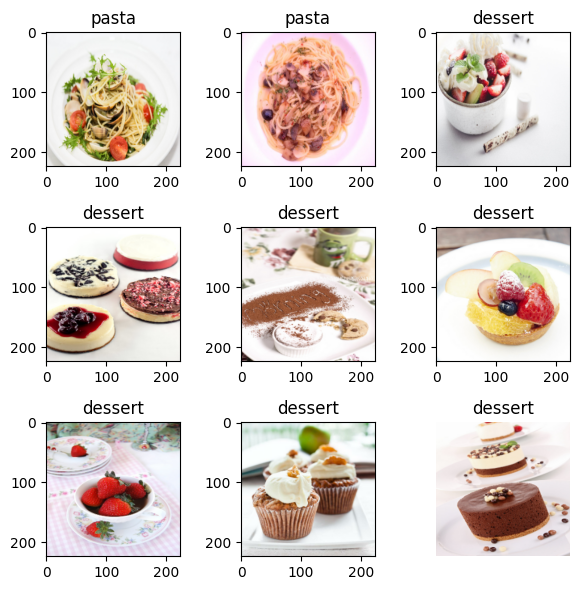

array([480,   7, 387, 418, 603, 422, 591, 205, 326])

In [ ]:
#Begin with the most representative images ¿what is the model paying attention too?
show_exciting_images(x_train, model, conv_layers[1], filter_idx=3)


In [ ]:
#Now do it per class
A1 = show_exciting_images(sep_sets['bbq'], model, conv_layers[1], filter_idx=3, name="bbq")

In [ ]:
#Now do it per class class_names = ('bbq', 'dessert', 'pasta', 'salad', 'sushi')
A2 = show_exciting_images(sep_sets['dessert'], model, conv_layers[1], filter_idx=3)

In [ ]:
#Now do it per class class_names = ('bbq', 'dessert', 'pasta', 'salad', 'sushi')
A3 = show_exciting_images(sep_sets['pasta'], model, conv_layers[1], filter_idx=3)

In [ ]:
#Now do it per class class_names = ('bbq', 'dessert', 'pasta', 'salad', 'sushi')
A4 = show_exciting_images(sep_sets['salad'], model, conv_layers[1], filter_idx=3)

In [ ]:
#Now do it per class class_names = ('bbq', 'dessert', 'pasta', 'salad', 'sushi')
A5 = show_exciting_images(sep_sets['sushi'], model, conv_layers[1], filter_idx=3)

In [ ]:
#Now that we have the most representative images lets work with the occlussion
Imp_images = [A1,A2,A3,A4,A5] #Get the indexes

In [ ]:
Imp_images #36, 45, 15, 145, 98

## What is the model paying attention to?

In [ ]:
test_instance = sep_sets['bbq'][36].astype("uint8")
plt.imshow(test_instance)

In [ ]:
def occlude_image(img, pos=(0, 0), size=32, color=(0.5, 0.5, 0.5)):
    img = img.copy()
    img[pos[0] : pos[0] + size, pos[1] : pos[1] + size, :] = color
    return img

In [ ]:
def generate_occluded_images(img, occlusion_size=64, stride = 1,  **kwargs): #All possoble occlusions, we consider a stride to reduce the number of possible images
    images = []
    for y in range(0, img.shape[0] - occlusion_size + 1, stride): #Consider a padding, move from 4 pixels, you have to also fix it on the range
        for x in range(0, img.shape[1] - occlusion_size + 1, stride):
            images.append(occlude_image(img, pos=(y, x), **kwargs))
    return np.array(images)

In [ ]:
occlusion_size = 32
stride = 2
occluded_images = generate_occluded_images(test_instance, occlusion_size=occlusion_size, stride = stride)
type(occluded_images)
occluded_images.shape

In [ ]:
#Note: Because the previous process fill the ram we save this as a file and load it later
from numpy import savez_compressed
#occluded_images.save('bbq')
savez_compressed('/content/drive/MyDrive/DL_Assignment_2/bbq2.npz', occluded_images)

In [ ]:
# load numpy array from npz file
from numpy import load
# load dict of arrays
dict_data = load('/content/drive/MyDrive/DL_Assignment_2/bbq.npz')
# extract the first array
occluded_images = dict_data['arr_0']
# print the array
occluded_images.shape #p1 = (21025, 224, 224, 3) p2= (9409, 224, 224, 3)

In [ ]:
original_pred = model.predict(np.array([test_instance]))[0]
original_prob = original_pred[np.argmax(original_pred)]
original_pred, np.argmax(original_pred), original_prob

In [ ]:
print(occluded_images.shape)
predictions = model.predict(occluded_images)
predictions.shape

(9409, 224, 224, 3)
295/295 ━━━━━━━━━━━━━━━━━━━━ 1777s 6s/step


(9409, 5)

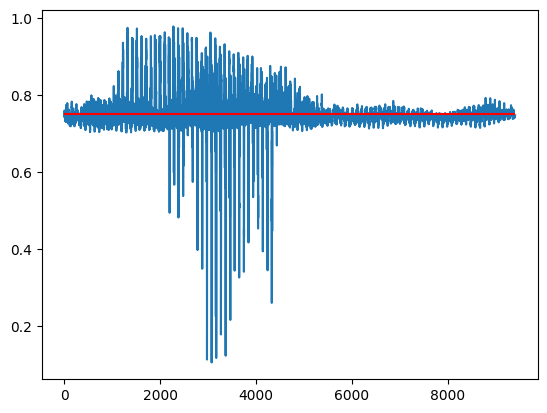

In [ ]:
plt.plot(predictions[:, np.argmax(original_pred)])
plt.hlines(original_prob, xmin=0, xmax=len(predictions), colors="r")

In [ ]:
from sklearn.preprocessing import minmax_scale
heatmap = np.zeros(test_instance.shape)

pred_idx = 0
for y in range(0, heatmap.shape[0] - occlusion_size + 1, stride): #consider de padding
    for x in range(0, heatmap.shape[1] - occlusion_size + 1, stride):
        prob = predictions[pred_idx, np.argmax(original_pred)]
        heatmap[y : y + occlusion_size, x : x + occlusion_size, :] += (max(0, original_prob - prob), 0, 0)
        pred_idx += 1

heatmap[:, :, 0] = minmax_scale(heatmap[:, :, 0]) #This map consider how the right probability is reduced, and not if it mis classified

In [ ]:
assert pred_idx == len(occluded_images)

In [ ]:
plt.imshow(test_instance, alpha=0.6)
plt.imshow(heatmap, alpha=0.7)

In [ ]:
heatmap = np.zeros(test_instance.shape)
stride = 2
pred_idx = 0
for y in range(0, heatmap.shape[0] - occlusion_size + 1, stride):
    for x in range(0, heatmap.shape[1] - occlusion_size + 1, stride):
        probs = predictions[pred_idx, :]
        if np.argmax(probs) != np.argmax(original_pred): #This means, if the prediction is wrong, then save the box
            heatmap[y : y + occlusion_size, x : x + occlusion_size, :] += (1, 0, 0)
        pred_idx += 1

heatmap[:, :, 0] = minmax_scale(heatmap[:, :, 0])

plt.imshow(test_instance, alpha=0.6)
plt.imshow(heatmap, alpha=0.7) #If no box appear then the box never change the prediction

In [ ]:



x= 10


for i in range(x):
  # plot the image
  plt.subplot(1, 2, 1)
  plt.axis("off")
  plt.imshow(x_test[i].numpy().astype("uint8"))
  plt.title(f'image of {class_names[(y_test[i])]}')

  # change dimentions
  image = tf.expand_dims(x_test[i], 0) # add a dimension
  heatmap = get_saliency_map(fullmodel, image, y_train[i]) #create a heatmap


  # Display heatmap
  plt.subplot(1, 2, 2)
  heatmap_sq = np.squeeze(heatmap, axis=0) # remove the added dimension
  plt.imshow(heatmap_sq)
  plt.title(f'heatmap for classification as {class_names[(y_test[i])]}')
  plt.axis("off")
  plt.show()